In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os


In [23]:
# Reading data from CSV
kunal_tweets=pd.read_csv('Kunal_Tweets.csv')
dinesh_tweets=pd.read_csv('Dinesh_Tweets.csv')
print("Total Tweets from Different Cities: %d"%(len(kunal_tweets)+len(dinesh_tweets)))


Total Tweets from Different Cities: 752002


In [24]:
# concatentaing Data

frames=[kunal_tweets,dinesh_tweets]
whole_tweet_data=pd.concat(frames,ignore_index=True)

c:\users\kunalverma\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:4: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  after removing the cwd from sys.path.


In [25]:
print(whole_tweet_data.head(),end="\n\n\n")
print(whole_tweet_data.shape)

   Unnamed: 0  Unnamed: 0.1  Unnamed: 0.1.1             city     country  \
0           0             0             0.0  Bouy-Luxembourg      France   
1        1120             0             0.0       Leudelange  Luxembourg   
2        1121             1             1.0       Leudelange  Luxembourg   
3        1122             2             2.0         Strassen  Luxembourg   
4        1124             4             4.0        Bertrange  Luxembourg   

                       created_at hashtags language  likes_count  \
0  Fri Nov 22 14:18:11 +0000 2019       []       tr           16   
1  Mon Nov 25 08:31:53 +0000 2019       []       de            0   
2  Mon Nov 25 08:20:59 +0000 2019       []       de            0   
3  Mon Nov 25 08:19:11 +0000 2019       []       tl            0   
4  Mon Nov 25 08:05:20 +0000 2019       []       tl            1   

   retweet_count             tweet_id  \
0              0  1197881970484826112   
1              0  1198881981993500672   
2          

# Preprocessing Tweet Texts

In [14]:
# Cleaning Data
## This code is the part of some other project.
from nltk.corpus import stopwords
from nltk.corpus import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer
import nltk
b="this is very bad cofee."
adjectives =[token for token, pos in nltk.pos_tag(nltk.word_tokenize(b)) if pos.startswith('JJ')]
adjectives

['bad']

### <font color='purple'> Removing Duplicate Tweets using Pandas</font>

In [27]:
whole_tweet_data.drop_duplicates(subset ="tweet_text", keep = False, inplace = True)
len(whole_tweet_data)

711758

### <font color='purple'> Removing Punctuation</font>


In [5]:
import string
def remove_punctuation(text):
    text_without_punct="".join(char for char in text if char not in string.punctuation)
    return text_without_punct

In [9]:
tokenize_data=RegexpTokenizer(r'\w+')
tokenize_data.tokenize(remove_punctuation("This is so sweet :) :) :/ u'\U0001F600-\U0001F64F'"))

['This', 'is', 'so', 'sweet', 'u']

In [29]:
whole_tweet_data["tweet_text"]=whole_tweet_data.tweet_text.apply(lambda x: remove_punctuation(x))
whole_tweet_data.tweet_text.head()

0    Hafta sonunu rahat geçirmek için eşşek gibi ça...
1    gmuecke geraederterdan andreasschliep Klingt s...
2    geraederterdan andreasschliep Ich mag die gene...
3      flabbygasted Tulog ka ate Daming drama Hahahaha
4    BlueiceDC03 Makareklamo ko mura jug wa naanad ...
Name: tweet_text, dtype: object

### <font color='purple'>Creating tokens out of the tweets.</font>

In [30]:
tokenize_data=RegexpTokenizer(r'\w+')
whole_tweet_data['tweet_text']=whole_tweet_data.tweet_text.apply(lambda text:tokenize_data.tokenize(text.lower()))
whole_tweet_data.tweet_text.head()

0    [hafta, sonunu, rahat, geçirmek, için, eşşek, ...
1    [gmuecke, geraederterdan, andreasschliep, klin...
2    [geraederterdan, andreasschliep, ich, mag, die...
3    [flabbygasted, tulog, ka, ate, daming, drama, ...
4    [blueicedc03, makareklamo, ko, mura, jug, wa, ...
Name: tweet_text, dtype: object

### <font color='purple'> Removing Stop words</font>


In [31]:
def remove_stop_words(tokenized_text):
    tokenized_text=[w for w in tokenized_text if w not in stopwords.words('english')]
    return tokenized_text

In [32]:
whole_tweet_data.tweet_text=whole_tweet_data.tweet_text.apply(lambda tokenized_text:remove_stop_words(tokenized_text))
whole_tweet_data.head()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,city,country,created_at,hashtags,language,likes_count,retweet_count,tweet_id,tweet_text
0,0,0,0.0,Bouy-Luxembourg,France,Fri Nov 22 14:18:11 +0000 2019,[],tr,16,0,1197881970484826112,"[hafta, sonunu, rahat, geçirmek, için, eşşek, ..."
1,1120,0,0.0,Leudelange,Luxembourg,Mon Nov 25 08:31:53 +0000 2019,[],de,0,0,1198881981993500672,"[gmuecke, geraederterdan, andreasschliep, klin..."
2,1121,1,1.0,Leudelange,Luxembourg,Mon Nov 25 08:20:59 +0000 2019,[],de,0,0,1198879239581425664,"[geraederterdan, andreasschliep, ich, mag, die..."
3,1122,2,2.0,Strassen,Luxembourg,Mon Nov 25 08:19:11 +0000 2019,[],tl,0,0,1198878788257566720,"[flabbygasted, tulog, ka, ate, daming, drama, ..."
4,1124,4,4.0,Bertrange,Luxembourg,Mon Nov 25 08:05:20 +0000 2019,[],tl,1,0,1198875302895783938,"[blueicedc03, makareklamo, ko, mura, jug, wa, ..."


In [33]:
whole_tweet_data.to_csv('data_without_stop_words.csv')

# Visualzation of the processed Data:

In [34]:
whole_tweet_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 711758 entries, 0 to 752001
Data columns (total 12 columns):
Unnamed: 0        711758 non-null int64
Unnamed: 0.1      711758 non-null int64
Unnamed: 0.1.1    269873 non-null float64
city              711758 non-null object
country           709637 non-null object
created_at        711758 non-null object
hashtags          711758 non-null object
language          711758 non-null object
likes_count       711758 non-null int64
retweet_count     711758 non-null int64
tweet_id          711758 non-null int64
tweet_text        711758 non-null object
dtypes: float64(1), int64(5), object(6)
memory usage: 70.6+ MB


In [36]:
whole_tweet_data=whole_tweet_data.drop(['Unnamed: 0','Unnamed: 0.1','Unnamed: 0.1.1'],axis=1)
whole_tweet_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 711758 entries, 0 to 752001
Data columns (total 9 columns):
city             711758 non-null object
country          709637 non-null object
created_at       711758 non-null object
hashtags         711758 non-null object
language         711758 non-null object
likes_count      711758 non-null int64
retweet_count    711758 non-null int64
tweet_id         711758 non-null int64
tweet_text       711758 non-null object
dtypes: int64(3), object(6)
memory usage: 54.3+ MB


### <font color='purple'>Analysing Data.</font>

In [38]:
round((whole_tweet_data.isnull().sum())/len(whole_tweet_data),2)

city             0.0
country          0.0
created_at       0.0
hashtags         0.0
language         0.0
likes_count      0.0
retweet_count    0.0
tweet_id         0.0
tweet_text       0.0
dtype: float64

In [39]:
whole_tweet_data=whole_tweet_data[whole_tweet_data['country'].notnull()]
whole_tweet_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 709637 entries, 0 to 752001
Data columns (total 9 columns):
city             709637 non-null object
country          709637 non-null object
created_at       709637 non-null object
hashtags         709637 non-null object
language         709637 non-null object
likes_count      709637 non-null int64
retweet_count    709637 non-null int64
tweet_id         709637 non-null int64
tweet_text       709637 non-null object
dtypes: int64(3), object(6)
memory usage: 54.1+ MB


In [40]:
round((whole_tweet_data.isnull().sum())/len(whole_tweet_data),2)

city             0.0
country          0.0
created_at       0.0
hashtags         0.0
language         0.0
likes_count      0.0
retweet_count    0.0
tweet_id         0.0
tweet_text       0.0
dtype: float64

In [101]:
dates=whole_tweet_data.created_at.str.slice(0,10,1)
# print(type(dates))
# print(dates[:10])
sliced_dates=pd.DataFrame(np.array(dates),columns=['Dates_sliced'])
# print(sliced_dates)
# print(sliced_dates)
whole_tweet_data=whole_tweet_data.join(sliced_dates)
# # whole_tweet_data=whole_tweet_data.drop(['Dates_sliced'],axis=1)
# # whole_tweet_data
whole_tweet_data.head()

,city,country,created_at,hashtags,language,likes_count,retweet_count,tweet_id,tweet_text,Dates_sliced
0,Bouy-Luxembourg,France,Fri Nov 22 14:18:11 +0000 2019,[],tr,16,0,1197881970484826112,"[hafta, sonunu, rahat, geçirmek, için, eşşek, ...",Fri Nov 22
1,Leudelange,Luxembourg,Mon Nov 25 08:31:53 +0000 2019,[],de,0,0,1198881981993500672,"[gmuecke, geraederterdan, andreasschliep, klin...",Mon Nov 25
2,Leudelange,Luxembourg,Mon Nov 25 08:20:59 +0000 2019,[],de,0,0,1198879239581425664,"[geraederterdan, andreasschliep, ich, mag, die...",Mon Nov 25
3,Strassen,Luxembourg,Mon Nov 25 08:19:11 +0000 2019,[],tl,0,0,1198878788257566720,"[flabbygasted, tulog, ka, ate, daming, drama, ...",Mon Nov 25
4,Bertrange,Luxembourg,Mon Nov 25 08:05:20 +0000 2019,[],tl,1,0,1198875302895783938,"[blueicedc03, makareklamo, ko, mura, jug, wa, ...",Mon Nov 25


### Number of Tweets/Day

In [2]:
Day_group=whole_tweet_data.groupby(whole_tweet_data['Dates_sliced'])
unique_dates=whole_tweet_data.Dates_sliced.unique()
# print(unique_dates[0:-1])
number_of_tweets_per_day=[]
# print(day)
for day in unique_dates[0:-1]:
    number_of_tweets_per_day.append(len(Day_group.get_group(day)))
# print(len(number_of_tweets_per_day))
# print(len(unique_dates[0:-1]))
unique_dates=unique_dates[0:-1]
index=np.arange(len(unique_dates))
plt.figure(figsize=(8,8))
plt.style.use('seaborn')
plt.plot(index, number_of_tweets_per_day,label="Tweets per Day")
plt.xlabel('Date', fontsize=9)
plt.ylabel('Number Of Tweets', fontsize=9)
plt.xticks(index, unique_dates, fontsize=9, rotation='vertical')
plt.title('Distribution of Tweets per day')
plt.legend()
plt.show()

NameError: name 'whole_tweet_data' is not defined

### Language Distribution

In [115]:
language_group=whole_tweet_data.groupby(whole_tweet_data["language"])
languages=whole_tweet_data.language.unique()
len(languages)

55

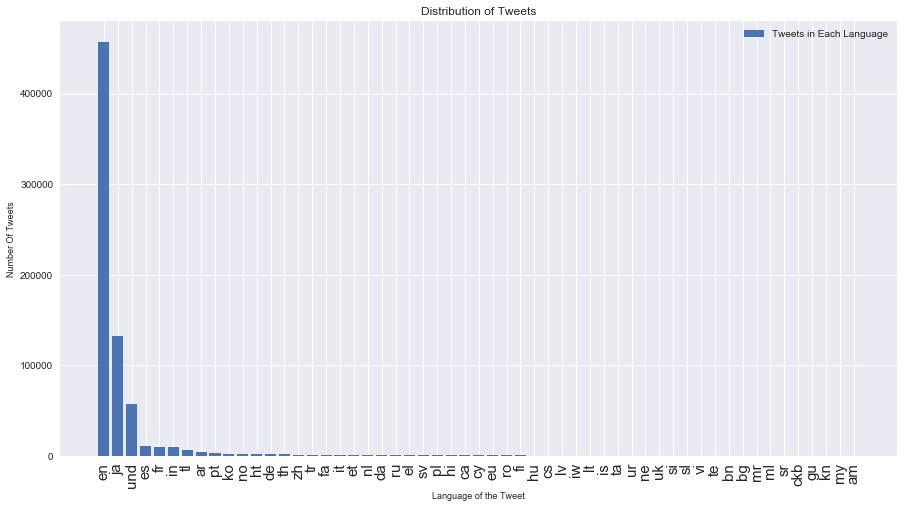

In [133]:
from matplotlib.pyplot import figure
number_of_tweets_in_each_language=[]
for l in languages:
    number_of_tweets_in_each_language.append((l,len(language_group.get_group(l))))
#print(number_of_tweets_in_each_language)
import operator
number_of_tweets_in_each_language.sort(key=lambda x: x[1], reverse=True)
for i in range(0,len(number_of_tweets_in_each_language)):
    languages[i]=number_of_tweets_in_each_language[i][0]
    number_of_tweets_in_each_language[i]=number_of_tweets_in_each_language[i][1]
    
    
index=np.arange(len(languages))
plt.figure(figsize=(15,8))
plt.style.use('seaborn')
plt.bar(index, number_of_tweets_in_each_language,label="Tweets in Each Language")
plt.xlabel('Language of the Tweet', fontsize=9)
plt.ylabel('Number Of Tweets', fontsize=9)
plt.xticks(index, languages, fontsize=15, rotation='vertical')
plt.title('Distribution of Tweets')
plt.legend()
plt.show()

### Polarity Analysis

In [170]:
from textblob import TextBlob

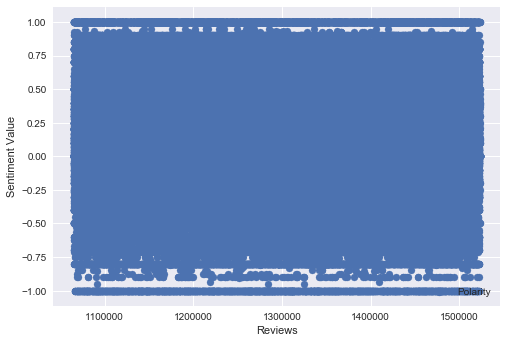

In [182]:
from textblob.sentiments import PatternAnalyzer
sentiment_analyzer=PatternAnalyzer()
temp=whole_tweet_data[whole_tweet_data['language']=='en']

sentiment_1=[]
subjectivity_1=[]
numlist=[]
for tweet in temp.tweet_text:
    ll=""
    l1=" ".join(tweet)
    sentiment_1.append(sentiment_analyzer.analyze(l1)[0])
    subjectivity_1.append(sentiment_analyzer.analyze(l1)[1])
    numlist.append(num)
    num=num+1
    
sentiment_1=np.array(sentiment_1)
subjectivity_1=np.array(subjectivity_1)

plt.style.use('seaborn')
plt.scatter(numlist,sentiment_1,label='Polarity')
plt.xlabel('Reviews')
plt.ylabel('Sentiment Value')
plt.legend()


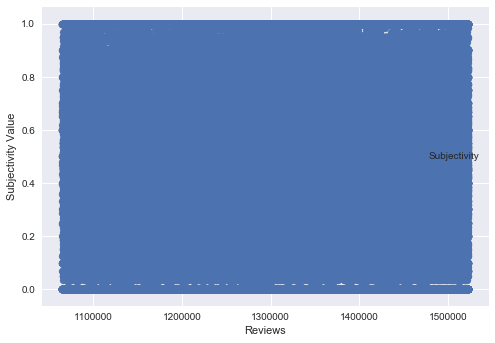

In [184]:
plt.style.use('seaborn')
plt.scatter(numlist,subjectivity_1,label='Subjectivity')
plt.xlabel('Reviews')
plt.ylabel('Subjectivity Value')
plt.legend()


In [186]:
temp['sentiment_value']=sentiment_1

c:\users\kunalverma\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [189]:
temp['subjectivity_value']=subjectivity_1

c:\users\kunalverma\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


<BarContainer object of 3 artists>

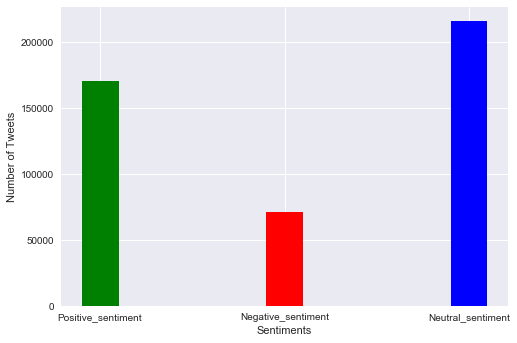

In [192]:
positive_sentiment_count=temp[temp['sentiment_value']>0.0]
negative_sentiment_count=temp[temp['sentiment_value']<0.0]
neutral_sentiment_count=temp[temp['sentiment_value']==0.0]

temp_array=[len(positive_sentiment_count),len(negative_sentiment_count),len(neutral_sentiment_count)]
x_axis_labels=['Positive_sentiment','Negative_sentiment','Neutral_sentiment']
plt.xlabel("Sentiments")
plt.ylabel("Number of Tweets")
plt.bar(x_axis_labels,temp_array,color=('green','red','blue'),width=(0.2,0.2,0.2))


<BarContainer object of 2 artists>

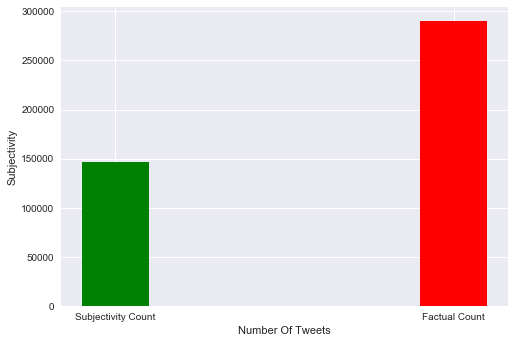

In [193]:
subjectivity_count=temp[temp['subjectivity_value']>0.5]
factual_count=temp[temp['subjectivity_value']<0.5]


temp_array=[len(subjectivity_count),len(factual_count)]
x_axis_labels=['Subjectivity Count','Factual Count']

plt.xlabel("Number Of Tweets")
plt.ylabel("Subjectivity")

plt.bar(x_axis_labels,temp_array,color=('green','red'),width=(0.2,0.2))


## Topic Research

In [267]:
features=['','christmas','blackfriday','trudeau','election','hockey','yoga','iphone']
x=np.array([1.0,2.0,3.0,4.0,5.0,6.0,7.0])

In [248]:


newdf=pd.concat([kunal_tweets,dinesh_tweets])
newdf.drop_duplicates(subset ="tweet_text", keep = False, inplace = True)
newdf=newdf[newdf.country.notnull()]
newdf=newdf.drop(['Unnamed: 0','Unnamed: 0.1','Unnamed: 0.1.1'],axis=1)
newdf=newdf[newdf.language=='en']
newdf['tweet_text']=newdf.tweet_text.apply(lambda text:text.lower())
newdf['sentiment_value']=sentiment_1

newdf.head()


c:\users\kunalverma\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  This is separate from the ipykernel package so we can avoid doing imports until


,city,country,created_at,hashtags,language,likes_count,retweet_count,tweet_id,tweet_text,sentiment_value
5,Mamer,Luxembourg,Mon Nov 25 08:04:15 +0000 2019,[],en,0,0,1198875026600218624,@runestenconsult fin tone,0.000000
14,Pétange,Luxembourg,Mon Nov 25 07:36:02 +0000 2019,[],en,1,0,1198867927774171136,@andylong @davehill_56 porcupine as well??,0.000000
15,Pétange,Luxembourg,Mon Nov 25 07:34:47 +0000 2019,[],en,0,0,1198867612085751808,@dayerisun @ice0fox top band did you guys list...,0.318182
19,Nommern,Luxembourg,Mon Nov 25 07:02:22 +0000 2019,"[{'text': 'Sunrise', 'indices': [29, 37]}]",en,0,0,1198859455426973696,"good morning, luxembourg! :) #sunrise 08:02, n...",0.700000
20,Bertrange,Luxembourg,Mon Nov 25 06:57:36 +0000 2019,[],en,1,0,1198858257613369345,@hoetoevallig succes,0.000000


In [264]:
avg_pos=[]
avg_neg=[]
avg_net=[]
for feature in features:
    temp=newdf[newdf.tweet_text.str.contains(feature)]
    avg_pos.append(len(temp[temp.sentiment_value>0.0]))
    avg_net.append(len(temp[temp.sentiment_value==0.0]))
    avg_neg.append(len(temp[temp.sentiment_value<0.0]))

In [265]:
for i in range(0,len(avg_pos)):
    print(avg_pos[i],avg_neg[i],avg_net[i])

809 231 932
25 11 36
35 15 54
195 73 240
194 81 225
117 29 85
116 40 136


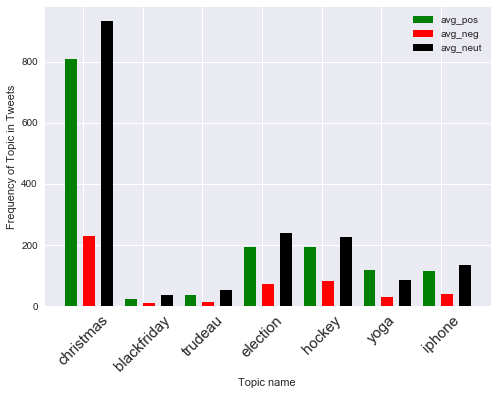

In [276]:
w=0.2

fig,ax=plt.subplots()
plt.bar(x-0.2,avg_pos,color='green',width=(0.2),label='avg_pos')
plt.bar(x+0.1,avg_neg,color='red',width=(0.2),label='avg_neg')
plt.bar(x+0.4,avg_net,color='black',width=0.2,label='avg_neut')
plt.xticks(rotation=45)
plt.ylabel("Frequency of Topic in Tweets")
plt.xlabel("Topic name ")
ax.set_xticklabels(features, fontsize=15)
plt.legend(loc='best')

## Frequently Used Words

In [297]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

newdf_1=whole_tweet_data.tweet_text[whole_tweet_data['language']=='en']
var=np.array(newdf_1)
var[0]

['runestenconsult', 'fin', 'tone']

In [292]:
var.shape

(457515,)

In [303]:
def xyz(abc):
    return " ".join(abc)

var_converted = [xyz(x) for x in var]
var_converted = np.array(var_converted)
var_converted[:5]

array(['runestenconsult fin tone', 'andylong davehill56 porcupine well',
       'dayerisun ice0fox top band guys listen live',
       'good morning luxembourg sunrise 0802 noon 1222 sunset 1642 cet utc1 november 25 day length 8h 40m',
       'hoetoevallig succes'], dtype='<U235')

In [300]:
var_result = xyz(var_converted)


'runestenconsult fin tone andylong davehill56 porcupine well dayerisun ice0fox top band guys listen live good morning luxembourg sunrise 0802 noon 1222 sunset 1642 cet utc1 november 25 day length 8h 40m hoetoevallig succes big congrats rochfordbrennan well deserved tireless work community ewgpwd diannegove httpstcom36h3whbo1 wildkait betting electto cars rather cars fueled h2o toyota making huge progresses ja httpstco5dfrbnvc9a unexpected stuff coming today might delay stream around hour today iss invoice software solution httpstcox18je8npzm official launch december 2019 test drive 14 days httpstcomwhkaojzt0 pamiph icheer mo daw httpstcoqgj2aut2x5 ever thought much data generate minute httpstconhphuqaw30 corkseashell racing92 munsterrugby know hoping saturday time make httpstcoaa2brxwgko last night httpstcog5oeqb9yuc nmsgib martyrs price women pay ask share stories httpstcoeo3xmah3cn via joedotie chibis0ra love guy httpstcodxaaz9djjv alisdavidson ukrunchat since first year first decade

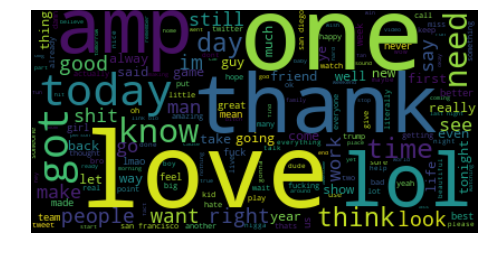

In [304]:
wordcloud = WordCloud().generate(var_result)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

(-0.5, 468.5, 639.5, -0.5)

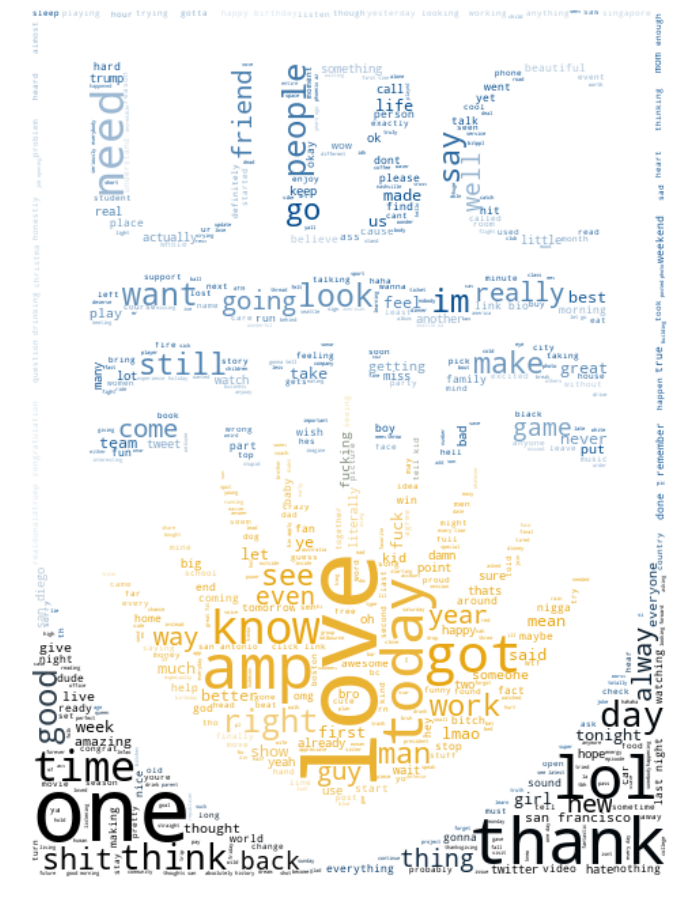

In [305]:
from PIL import Image
import requests
from io import BytesIO
response = requests.get("https://www.slim.eos.ubc.ca/sites/data/images/UBC_logo.png")

mask = np.array(Image.open(BytesIO(response.content)))
wordcloud_fra = WordCloud(background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(var_result)

# create coloring from image
image_colors = ImageColorGenerator(mask)
plt.figure(figsize=[16,16])
plt.imshow(wordcloud_fra.recolor(color_func=image_colors), interpolation="bilinear")
plt.axis("off")